In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import pyproj
import seaborn as sns
from random import shuffle, randint
from tqdm import tqdm
from sklearn.neighbors import BallTree,KDTree
from sklearn.neighbors import DistanceMetric
from sklearn.metrics.pairwise import haversine_distances, euclidean_distances
from sklearn.preprocessing import OrdinalEncoder, OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from math import radians
from sklearn.ensemble import RandomForestRegressor
from catboost import CatBoostRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import train_test_split 
pd.set_option('display.max_columns', None)
from scipy.spatial import distance_matrix
from verstack.stratified_continuous_split import scsplit
from lightgbm import LGBMRegressor,LGBMClassifier
from sklearn.inspection import permutation_importance
from pyproj import Proj, transform


from keras import Model
from tensorflow import keras
from keras.layers import Dense, Input
from keras.wrappers.scikit_learn import KerasRegressor
from keras.callbacks import EarlyStopping
from random import randint
from sklearn.ensemble import VotingRegressor
import tensorflow as tf 
from keras.models import Sequential
from keras.layers import Dropout, BatchNormalization
from math import radians,degrees

import folium
from folium.plugins import HeatMap
import branca
import branca.colormap as cm

import pickle


Using TensorFlow backend.


In [52]:
DEPARTMENT = 92

ERROR! Session/line number was not unique in database. History logging moved to new session 672


In [53]:
df = pd.read_csv('../Datas/Processed_data/{}.csv'.format(DEPARTMENT))

In [55]:
df

,id_mutation,nature_mutation,valeur_fonciere,code_postal,code_commune,code_departement,type_local,surface_reelle_bati,nombre_pieces_principales,surface_terrain,longitude,latitude,type_local_str,year,quarter,month,Prix_m2_bati,Prix_m2_total,nb_transac_quarter,evol_quarter,nb_transac_total,Nb de pers. non scolarisées de 15 ans ou + 2017,Part des non ou peu diplômés dans la pop. non scolarisée de 15 ans ou + 2017,"Part des pers., dont le diplôme le plus élevé est le bepc ou le brevet, dans la pop. non scolarisée de 15 ans ou + 2017","Part des pers., dont le diplôme le plus élevé est un CAP ou un BEP, dans la pop. non scolarisée de 15 ans ou + 2017","Part des pers., dont le diplôme le plus élevé est le bac, dans la pop. non scolarisée de 15 ans ou + 2017",Part des diplômés d'un BAC+2 dans la pop. non scolarisée de 15 ans ou + 2017,Part des diplômés d'un BAC+3 ou BAC+4 dans la pop. non scolarisée de 15 ans ou + 2017,Taux d'activité par tranche d'âge 2017,Nb d'emplois au lieu de travail (LT) 2017,Part des emplois sal. dans le nb d’emplois au LT 2017,Part des agriculteurs expl. dans le nb d’emplois au LT 2017,"Part des artisans, commerçants, chefs d’ent. dans le nb d’emplois au LT 2017",Part des cadres et prof. intellectuelles sup. dans le nb d’emplois au LT 2017,Part des prof. intermédiaires dans le nb d’emplois au LT 2017,Part des employés dans le nb d’emplois au LT 2017,Part des ouvriers dans le nb d’emplois au LT 2017,Taux d'activité par tranche d'âge 2017.1,Taux d'activité par tranche d'âge 2017.2,Résidences principales 2017,Part des logements vacants dans le total des logements 2017,Part des rés. principales dans le total des logements 2017,Part des rés. secondaires (y compris les logements occasionnels) dans le total des logements 2017,Part des locataires dans les rés. principales 2017,Part des locataires HLM dans les rés. principales 2017,Part des rés. principales construites avant 1946 2017,Police - Gendarmerie 2019,Pôle emploi 2019,Banques 2019,Point de contact postal 2019,Hypermarché - Supermarché 2019,Supérette - Épicerie 2019,Boulangerie 2019,Boucherie charcuterie 2019,Poissonnerie 2019,École maternelle 2019,École élémentaire 2019,Collège 2019,Lycée 2019,Service d'urgences 2019,Médecin généraliste 2019,Chirurgien dentiste 2019,Infirmier 2019,Masseur kinésithérapeute 2019,Pharmacie 2019,Hébergement des personnes âgées 2019,dist_min_lycee,type_plus_proche_lycee,dist_min_5_lycee,dist_min_maternelle,dist_min_ecoles_elementaires,dist_min_colleges,dist_min_5_colleges,dist_min_sup,dist_min_5_sup,dist_min_supermarche,dist_min_boulangerie,dist_min_boucherie,dist_min_poste,dist_min_pharmacie,dist_min_aeroport,dist_min_culture,dist_min_generaliste,dist_min_banque,dist_min_urgence,dist_min_specialiste,dist_min_dent,dist_min_infirimier,dist_min_creche,dist_min_gare,voisinage,voisinage_total,mean_dist_5_NN,mean_dist_10_NN,mean_dist_20_NN,mean_dist_25_NN,mean_dist_50_NN,mean_dist_75_NN,mean_dist_100_NN,std_dist_5_NN,std_dist_10_NN,std_dist_20_NN,std_dist_25_NN,std_dist_50_NN,std_dist_75_NN,std_dist_100_NN,Distance_plus_proche_ferré,Distance_moyenne_5_plus_proches_ferrés,Distance_moyenne_10_plus_proches_ferrés,Type_plus_proche_ferré,ligne_plus_proche_ferré,Noctilien_plus_proche,Distance_plus_proche_bus,Distance_moyenne_5_plus_proches_bus,Distance_moyenne_10_plus_proches_bus,std_distance_5_plus_proches_bus,std_distance_10_plus_proches_bus
0,2014-968972,Vente,325000.0,92150.0,92073,92,0.0,30.0,1,0.0,0.038767,0.852837,Appartement,2014,1,1,10833.333333,10833.333333,131,0.000000,4043,33776.0,13.6,3.7,11.4,13.7,10.9,13.0,94.2,29115.0,91.6,0.0,4.0,45.1,25.3,19.4,6.1,36.2,70.2,21279.0,5.5,92.6,1.9,60.1,31.9,22.9,1,0,18,5,8,23,26,11,0,9,11,3,2,1,30,40,21,31,15,5,1.355760,C302,1.701293,0.099217,0.149609,0.991042,1.478228,0.325774,1.028747,101.097387,100.075147,100.124927,100.082955,100.724108,262.924874,118.868983,113.943591,100.989296,129.149138,100.253455,103.322795,100.220906,100.075437,100.768228,6446.535245,6446.535245,0.000000,0.000003,6.07

In [59]:
# SEVERE OUTLIER, my be interesting to relaunch the NN voisinage conputation

In [79]:
df.dropna(inplace=True)
df = df[(df.Prix_m2_bati> 1000) & (df.Prix_m2_bati < 20000)].reset_index(drop=True)

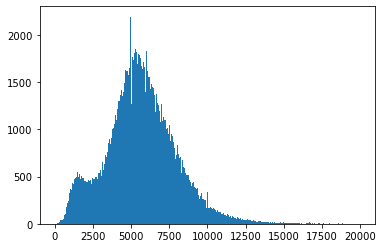

In [80]:
plt.hist(df.Prix_m2_total,bins=300);

# Plot heat map of the price on the target city : 

In [81]:
df['longitude_real'] = df.longitude.apply(degrees)
df['latitude_real'] = df.latitude.apply(degrees)

In [82]:
# Takes a lot of memory, increase nb_plots for more details
# Static map after that

center = [48.828508,2.2188068]
nb_plots = 5e4

hmap = folium.Map(location= center, zoom_start=10)

max_price = float(df['Prix_m2_bati'].max())
min_price = float(df['Prix_m2_bati'].min())
colormap = cm.LinearColormap(colors=['blue','red'], vmin=min_price,vmax=max_price)



lat = list(df.loc[:nb_plots].latitude_real)
lon = list(df.loc[:nb_plots].longitude_real)
price = list(df.loc[:nb_plots].Prix_m2_bati)


for loc, p in tqdm(zip(zip(lat, lon), price)):
    folium.Circle(
        location=loc,
        radius=10,
        fill=True,
        color=colormap(p),
    ).add_to(hmap)
    
hmap.add_child(colormap)

display(hmap)

50001it [00:01, 25224.15it/s]


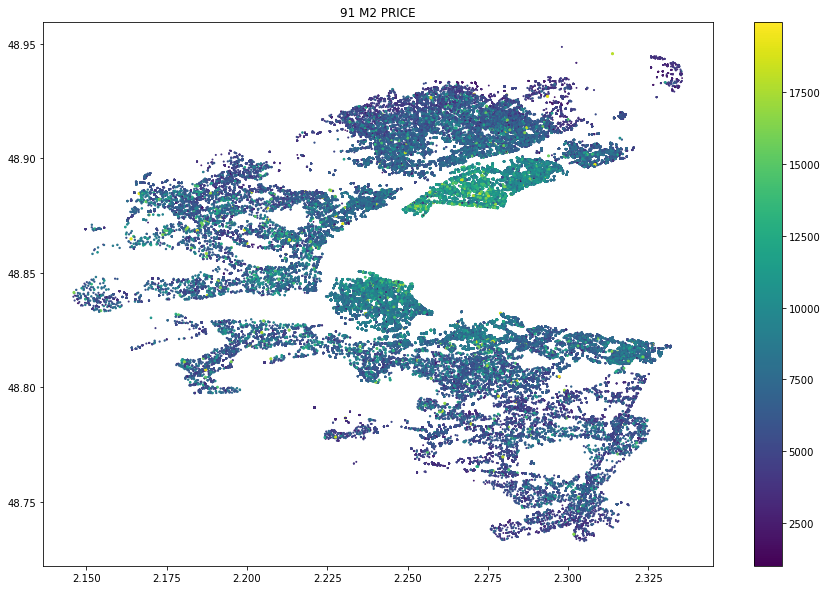

In [84]:
plt.figure(figsize = (15,10))
plt.scatter(df.longitude_real.values,df.latitude_real.values, c = df.Prix_m2_bati.values,s=5*df.Prix_m2_bati.values/df.Prix_m2_bati.values.max())
plt.colorbar()
plt.title('91 M2 PRICE')
plt.show()

In [85]:
def evaluate_model(y_test,y_pred):
    error= np.abs((y_test-y_pred)/y_test)*100
    print('Mean absolute percentage error = {}'.format(np.mean(error)))
    print('Median absolute percentage error = {}'.format(np.median(error)))

In [86]:
X_train, X_test, Y_train, Y_test = scsplit(df,df.Prix_m2_bati,test_size = 0.2,train_size = 0.8,stratify = df.valeur_fonciere,random_state=10)

In [87]:
index_train = X_train.index
index_test = X_test.index

prix_m2_train = Y_train.values
prix_m2_test = Y_test.values
vf_train = df.loc[index_train].valeur_fonciere
vf_test = df.loc[index_test].valeur_fonciere

In [88]:
categorical_features = ['nombre_pieces_principales','type_local','year']

quantitative_features = [
 'surface_reelle_bati',
 'surface_terrain',
 'nb_transac_quarter',
 'nb_transac_total',
 'Part des non ou peu diplômés dans la pop. non scolarisée de 15 ans ou + 2017',
 'Part des pers., dont le diplôme le plus élevé est le bepc ou le brevet, dans la pop. non scolarisée de 15 ans ou + 2017',
 'Part des pers., dont le diplôme le plus élevé est un CAP ou un BEP, dans la pop. non scolarisée de 15 ans ou + 2017',
 'Part des pers., dont le diplôme le plus élevé est le bac, dans la pop. non scolarisée de 15 ans ou + 2017',
 "Part des diplômés d'un BAC+3  ou BAC+4 dans la pop. non scolarisée de 15 ans ou + 2017",
 "Taux d'activité par tranche d'âge 2017",
 "Nb d'emplois au lieu de travail (LT) 2017",
 'Part des emplois sal. dans le nb d’emplois au LT 2017',
 'Part des cadres et prof. intellectuelles sup. dans le nb d’emplois au LT 2017',
 'Part des employés dans le nb d’emplois au LT 2017',
 "Taux d'activité par tranche d'âge 2017.1",
 "Taux d'activité par tranche d'âge 2017.2",
 'Résidences principales 2017',
 'dist_min_lycee',
 'dist_min_5_lycee',
 'dist_min_maternelle',
 'dist_min_ecoles_elementaires',
 'dist_min_colleges',
 'dist_min_5_colleges',
 'dist_min_sup',
 'dist_min_5_sup',
 'dist_min_supermarche',
 'dist_min_boulangerie',
 'dist_min_poste',
 'dist_min_pharmacie',
 'dist_min_aeroport',
 'dist_min_culture',
 'dist_min_generaliste',
 'dist_min_banque',
 'dist_min_urgence',
 'dist_min_specialiste',
 'dist_min_dent',
 'dist_min_infirimier',
 'dist_min_gare',
 'voisinage',
 'voisinage_total',
 'mean_dist_5_NN',
 'mean_dist_10_NN',
 'mean_dist_20_NN',
 'mean_dist_25_NN',
 'mean_dist_50_NN',
 'std_dist_5_NN',
 'std_dist_10_NN',
 'std_dist_20_NN',
 'std_dist_25_NN',
 'std_dist_50_NN',
 'Distance_plus_proche_ferré',
 'Distance_moyenne_5_plus_proches_ferrés',
 'Distance_moyenne_10_plus_proches_ferrés',
 'Noctilien_plus_proche',
 'Distance_plus_proche_bus',
 'Distance_moyenne_5_plus_proches_bus',
 'Distance_moyenne_10_plus_proches_bus',
 'std_distance_5_plus_proches_bus',
 'std_distance_10_plus_proches_bus']


X_train = X_train[categorical_features + quantitative_features]
X_test = X_test[categorical_features + quantitative_features]

In [89]:
preprocessor = ColumnTransformer(
        [
            ("preprocessor_cat",OneHotEncoder(handle_unknown = 'ignore'),categorical_features),
            ("preprocessor_quant",StandardScaler(),quantitative_features)
            
        ], remainder = 'drop')

In [90]:
MODEL = Pipeline(
        [
            ("preprocessor",preprocessor),
            ("regressor",LGBMRegressor(learning_rate=0.2,n_estimators=1000))
        ])


In [91]:
MODEL.fit(X_train,Y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('preprocessor_cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['nombre_pieces_principales',
                                                   'type_local', 'year']),
                                                 ('preprocessor_quant',
                                                  StandardScaler(),
                                                  ['surface_reelle_bati',
                                                   'surface_terrain',
                                                   'nb_transac_quarter',
                                                   'nb_transac_total',
                                                   'Part des non ou peu '
                                                   'diplômés dans la pop. non '
                                                   'scolarisée de 15 a

In [92]:
predicted = MODEL.predict(X_test)
evaluate_model(Y_test,predicted)

Mean absolute percentage error = 16.307226963679227
Median absolute percentage error = 9.571648659229215


In [93]:
valeur_fonciere = vf_test
prediction_vf = predicted*X_test.surface_reelle_bati

In [94]:
evaluate_model(valeur_fonciere,prediction_vf)

Mean absolute percentage error = 16.307226963679227
Median absolute percentage error = 9.571648659229224


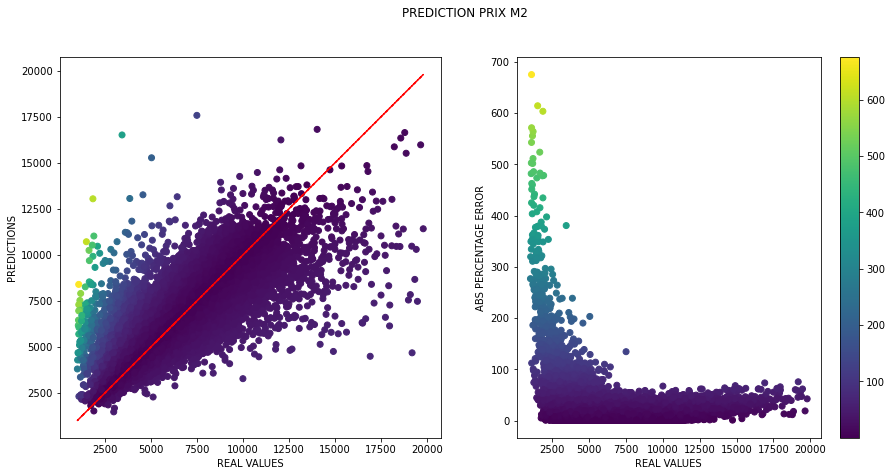

In [95]:
mape = np.abs((predicted - Y_test)/Y_test)*100

plt.figure(figsize = (15,7))
plt.subplot(1,2,1)
plt.scatter(Y_test,predicted,c= mape)
plt.plot(Y_test,Y_test,'r--')
plt.xlabel('REAL VALUES')
plt.ylabel('PREDICTIONS')
plt.subplot(1,2,2)
mape = np.abs((predicted - Y_test)/Y_test)*100
plt.scatter(Y_test,mape,c= mape)
plt.xlabel('REAL VALUES')
plt.ylabel('ABS PERCENTAGE ERROR')
plt.suptitle('PREDICTION PRIX M2')
plt.colorbar()

Mean absolute percentage error = 16.307226963679227
Median absolute percentage error = 9.571648659229224


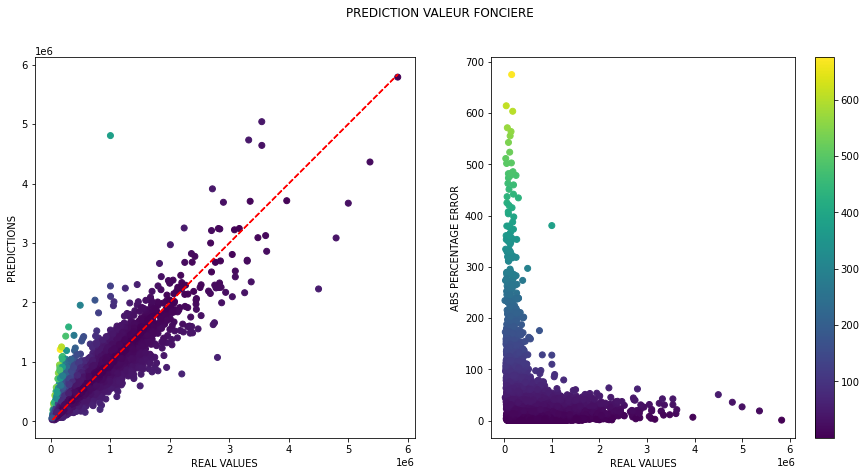

In [96]:
mape = np.abs((valeur_fonciere - prediction_vf)/valeur_fonciere)*100

evaluate_model(valeur_fonciere,prediction_vf)

plt.figure(figsize = (15,7))
plt.subplot(1,2,1)
plt.scatter(valeur_fonciere,prediction_vf,c= mape)
plt.plot(valeur_fonciere,valeur_fonciere,'r--')
plt.xlabel('REAL VALUES')
plt.ylabel('PREDICTIONS')
plt.subplot(1,2,2)

plt.scatter(valeur_fonciere,mape,c= mape)
plt.xlabel('REAL VALUES')
plt.ylabel('ABS PERCENTAGE ERROR')
plt.suptitle('PREDICTION VALEUR FONCIERE')
plt.colorbar()

# Spatial distribution of the error : 

In [97]:
error = mape

hmap = folium.Map(location= center, zoom_start=10)

df_test = df[df.index.isin(index_test)] 
nb_plots = 1e3

max_error = max(error)
min_error = min(error)
mean_error = np.mean(error)
med_error = np.median(error)
colormap = cm.LinearColormap(colors=['lightblue','red'], index = [min_error,max_error],
                             vmin=min_error,vmax=max_error)



lat = list(df_test.reset_index().loc[:nb_plots].latitude_real)
lon = list(df_test.reset_index().loc[:nb_plots].longitude_real)
price = list(error)


for loc, p in tqdm(zip(zip(lat, lon), error)):
    folium.Circle(
        location=loc,
        radius=p,
        fill=True,
        color=colormap(p),
        fill_opacity=p/max_error).add_to(hmap)
    
hmap.add_child(colormap)

display(hmap)

1001it [00:00, 25669.15it/s]


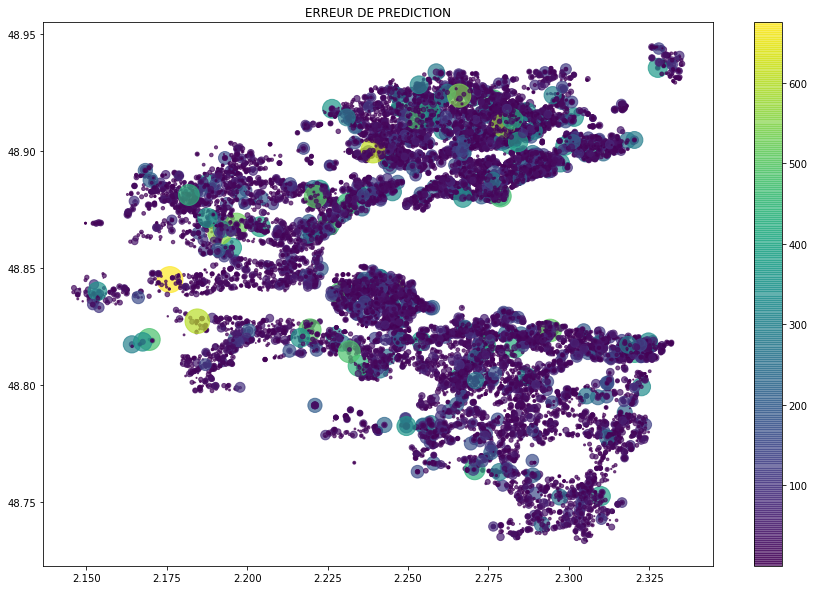

In [118]:
plt.figure(figsize = (15,10))
plt.scatter(df_test.longitude_real.values,df_test.latitude_real.values, c = error,s=error,alpha=0.7)
plt.colorbar()
plt.title('ERREUR DE PREDICTION')
plt.show()

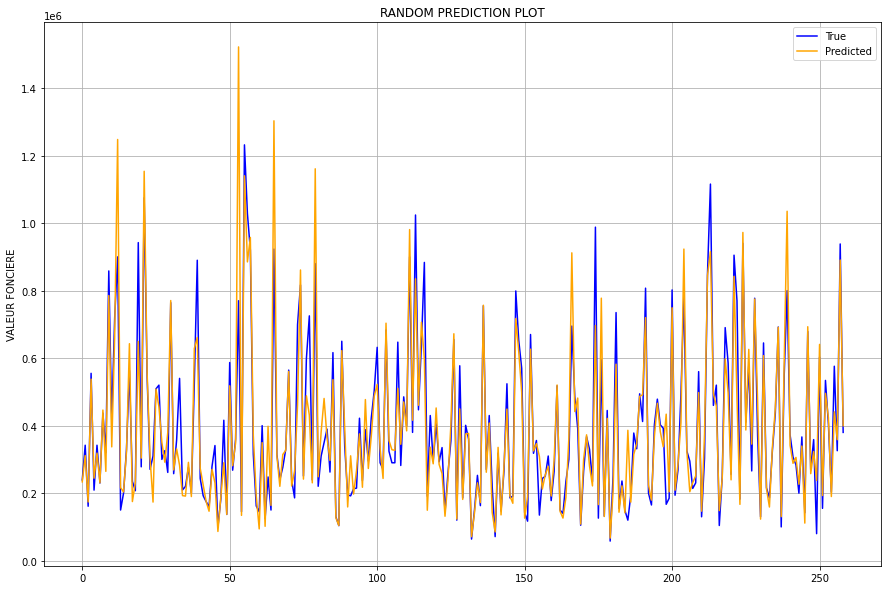

In [99]:
plt.figure(figsize=(15,10))
n = len(Y_test)
number = int(n/100)
array = np.arange(n)
shuffle(array)

i = randint(0,n-number)

prediction = prediction_vf
prediction_plot = []
true_plot = []

for indice in array[i:i+number]:
    true_plot.append(valeur_fonciere.values[indice])
    prediction_plot.append(prediction.values[indice])
    

plt.plot(range(number),true_plot,'b',label='True')
plt.plot(range(number),prediction_plot,'orange',label='Predicted')
plt.grid()
plt.title('RANDOM PREDICTION PLOT')
plt.ylabel('VALEUR FONCIERE')
plt.legend()

In [100]:
n_repeats = 5

feature_importances = permutation_importance(
    MODEL, X_test, Y_test, n_repeats=n_repeats
)

In [101]:
sorted_idx = feature_importances.importances_mean.argsort()[::-1]
names = X_test.columns.copy()

for i in range(len(names)):
    features = feature_importances.importances[sorted_idx].T[:,i]
    series = pd.Series(features)
    if i == 0 :
        dfa = pd.DataFrame(series,columns = ['Importance'])
        dfa['Features'] = np.array(names)[sorted_idx][i]
    else : 
        df2 = pd.DataFrame(series,columns = ['Importance'])
        df2['Features'] = np.array(names)[sorted_idx][i]
        dfa = pd.concat([dfa,df2])

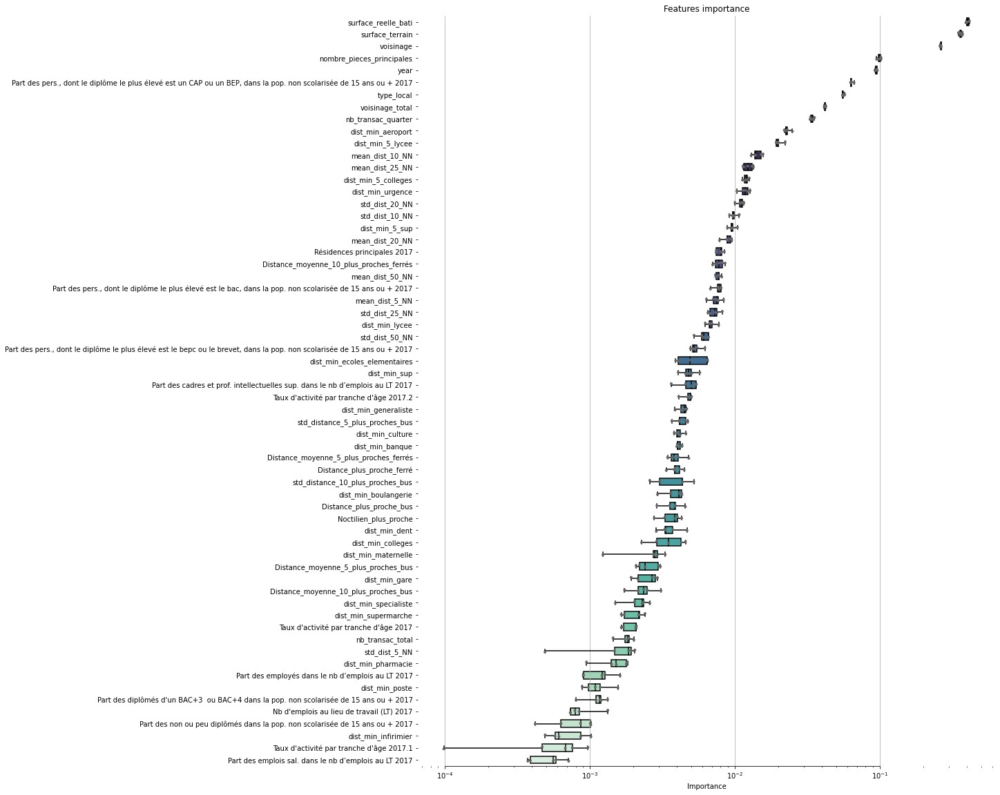

In [102]:
# Plot the orbital period with horizontal boxes

f, ax = plt.subplots(figsize=(15,20))
ax.set_xscale("log")
sns.boxplot(x='Importance', y='Features',data=dfa,
            whis=[0, 100], width=.6, palette="mako")


sns.stripplot(x='Importance', y='Features',data=dfa,
              size=4, color=".4", linewidth=0)

# Tweak the visual presentation
ax.xaxis.grid(True)
ax.set(ylabel="")
sns.despine(trim=True, left=True)
ax.set_title('Features importance');

# Neural Network

In [103]:
X_pre_train = X_train.copy()
X_pre_test = X_test.copy()
Y_train = prix_m2_train
Y_test = prix_m2_test

In [104]:
X_train_keras = preprocessor.transform(X_pre_train[categorical_features + quantitative_features])
X_test_keras = preprocessor.transform(X_pre_test[categorical_features + quantitative_features])

In [105]:
callback = EarlyStopping(patience=15,restore_best_weights = True)

In [106]:
# Decalaration of our neural network architechture. We use batchnormalization layers as well 
# as dropout to prevent overfitting
def create_network():
    model = Sequential()
    model.add(Dense(16, activation='relu',input_shape = (X_train_keras.shape[1],)))
    model.add(Dense(32, activation='relu'))
    model.add(Dense(64,activation='relu'))
    model.add(Dense(32, activation='selu'))
    model.add(Dense(16, activation='selu'))
    model.add(Dense(8, activation='selu'))
    model.add(Dense(1, activation='linear'))

    model.compile(optimizer = 'adam', loss = 'mean_absolute_error')

    return model

In [107]:
keras_regressor = KerasRegressor(build_fn=create_network, epochs=1500,verbose=1,batch_size = 128)

In [108]:
keras_regressor.fit(X_train_keras,Y_train,callbacks=[callback],validation_split=0.2)

Train on 82984 samples, validate on 20746 samples
Epoch 1/1500
82984/82984 [==============================] - 2s 23us/step - loss: 1939.0365 - val_loss: 1076.0379
Epoch 2/1500
82984/82984 [==============================] - 2s 21us/step - loss: 1045.1535 - val_loss: 1022.8088
Epoch 3/1500
82984/82984 [==============================] - 2s 24us/step - loss: 1017.7537 - val_loss: 1015.4106
Epoch 4/1500
82984/82984 [==============================] - 2s 24us/step - loss: 1006.8752 - val_loss: 996.0216
Epoch 5/1500
82984/82984 [==============================] - 2s 23us/step - loss: 1001.9990 - val_loss: 1001.5613
Epoch 6/1500
82984/82984 [==============================] - 2s 22us/step - loss: 998.5393 - val_loss: 985.6069
Epoch 7/1500
82984/82984 [==============================] - 2s 21us/step - loss: 994.4100 - val_loss: 987.7032
Epoch 8/1500
82984/82984 [==============================] - 2s 20us/step - loss: 991.5468 - val_loss: 996.9725
Epoch 9/1500
82984/82984 [===========================

82984/82984 [==============================] - 2s 19us/step - loss: 945.4701 - val_loss: 947.1830
Epoch 74/1500
82984/82984 [==============================] - 1s 18us/step - loss: 944.6497 - val_loss: 942.8361
Epoch 75/1500
82984/82984 [==============================] - 1s 18us/step - loss: 941.9333 - val_loss: 940.7494
Epoch 76/1500
82984/82984 [==============================] - 1s 17us/step - loss: 939.5569 - val_loss: 943.5886
Epoch 77/1500
82984/82984 [==============================] - 1s 17us/step - loss: 936.5142 - val_loss: 940.8342
Epoch 78/1500
82984/82984 [==============================] - 1s 17us/step - loss: 935.1025 - val_loss: 937.3653
Epoch 79/1500
82984/82984 [==============================] - 1s 17us/step - loss: 932.5953 - val_loss: 937.3671
Epoch 80/1500
82984/82984 [==============================] - 1s 17us/step - loss: 931.9791 - val_loss: 932.1651
Epoch 81/1500
82984/82984 [==============================] - 1s 17us/step - loss: 928.6957 - val_loss: 936.4072
Epoch 

82984/82984 [==============================] - 2s 18us/step - loss: 906.4668 - val_loss: 914.3980


In [109]:
prediction = keras_regressor.predict(X_test_keras)
evaluate_model(prediction,Y_test)

25933/25933 [==============================] - 0s 6us/step
Mean absolute percentage error = 14.388943664333556
Median absolute percentage error = 10.099737082682193


In [110]:
prediction_vf = prediction*X_test.surface_reelle_bati
evaluate_model(prediction_vf,vf_test)

Mean absolute percentage error = 14.388943664333569
Median absolute percentage error = 10.09973708268219


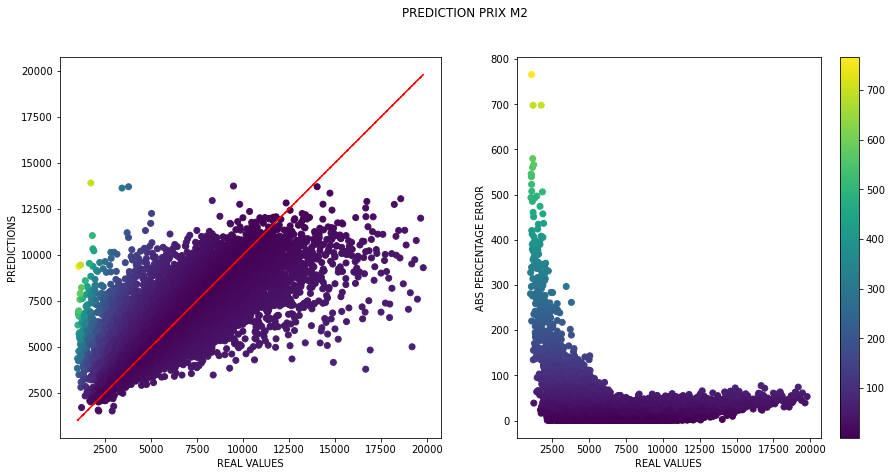

In [111]:
mape = np.abs((prediction - Y_test)/Y_test)*100

plt.figure(figsize = (15,7))
plt.subplot(1,2,1)
plt.scatter(Y_test,prediction,c= mape)
plt.plot(Y_test,Y_test,'r--')
plt.xlabel('REAL VALUES')
plt.ylabel('PREDICTIONS')
plt.subplot(1,2,2)
mape = np.abs((prediction - Y_test)/Y_test)*100
plt.scatter(Y_test,mape,c= mape)
plt.xlabel('REAL VALUES')
plt.ylabel('ABS PERCENTAGE ERROR')
plt.suptitle('PREDICTION PRIX M2')
plt.colorbar()

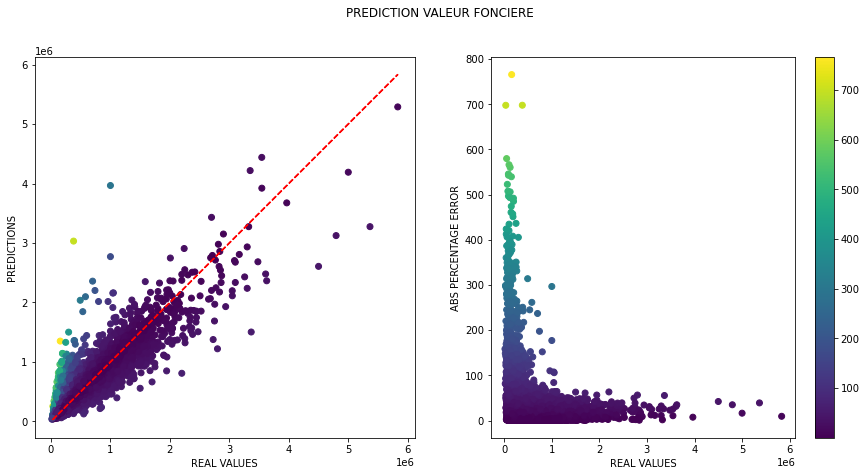

In [112]:
mape = np.abs((vf_test - prediction_vf)/vf_test)*100

plt.figure(figsize = (15,7))
plt.subplot(1,2,1)
plt.scatter(vf_test,prediction_vf,c= mape)
plt.plot(vf_test,vf_test,'r--')
plt.xlabel('REAL VALUES')
plt.ylabel('PREDICTIONS')
plt.subplot(1,2,2)

plt.scatter(vf_test,mape,c= mape)
plt.xlabel('REAL VALUES')
plt.ylabel('ABS PERCENTAGE ERROR')
plt.suptitle('PREDICTION VALEUR FONCIERE')
plt.colorbar();

# MIXED MODEL 

In [113]:
mixed = np.average([prediction,predicted],axis=0,weights=[0.5,0.5])
evaluate_model(mixed,Y_test)

Mean absolute percentage error = 13.650707538244205
Median absolute percentage error = 9.47421743745769


In [114]:
part_keras = np.linspace(0,1,101)
list_mape = []
min_loss = np.inf 
best_tradeoff = 0
best_mixed = mixed

for i in part_keras : 
    mixed = np.average([prediction,predicted],axis=0,weights=[i,1-i])
    mae = np.mean(np.abs(mixed-Y_test))
    list_mape.append(mae)
    if mae < min_loss : 
        best_tradeoff = i 
        min_loss = mae
        best_mixed = mixed
        

Text(0.5, 1.0, 'BEST PART KERAS : 0.32')

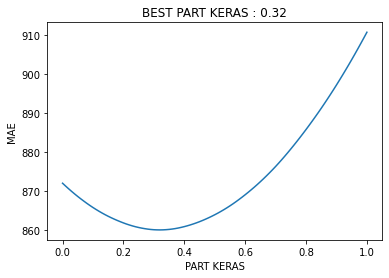

In [115]:
plt.figure()
plt.plot(part_keras,list_mape)
plt.ylabel('MAE')
plt.xlabel('PART KERAS')
plt.title('BEST PART KERAS : {}'.format(best_tradeoff))

In [116]:
evaluate_model(best_mixed,Y_test)

Mean absolute percentage error = 13.604713118615647
Median absolute percentage error = 9.43686232124939


In [117]:
Boundary = 20

ap_error = (np.abs(best_mixed - Y_test)/Y_test)*100
print("Prediction with less than {}% error represents {}% of predictions.".format(Boundary,(1 - (len(Y_test) - sum(ap_error < Boundary))/len(Y_test))*100))

Prediction with less than 20% error represents 79.20410288049975% of predictions.


# Make the true training of the two models, save optimal tradeoff

In [44]:
X = df[categorical_features + quantitative_features]
Y = df.Prix_m2_bati

In [45]:
preprocessor = ColumnTransformer(
        [
            ("preprocessor_cat",OneHotEncoder(handle_unknown = 'ignore'),categorical_features),
            ("preprocessor_quant",StandardScaler(),quantitative_features)
            
        ], remainder = 'drop')

In [46]:
MODEL = Pipeline(
        [
            ("preprocessor",preprocessor),
            ("regressor",LGBMRegressor(learning_rate=0.2,n_estimators=1000))
        ])

In [47]:
MODEL.fit(X,Y)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('preprocessor_cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['nombre_pieces_principales',
                                                   'type_local', 'year']),
                                                 ('preprocessor_quant',
                                                  StandardScaler(),
                                                  ['surface_reelle_bati',
                                                   'surface_terrain',
                                                   'nb_transac_quarter',
                                                   'nb_transac_total',
                                                   'Part des non ou peu '
                                                   'diplômés dans la pop. non '
                                                   'scolarisée de 15 a

In [48]:
X_keras = preprocessor.transform(X)

In [49]:
callback = EarlyStopping(patience=15,restore_best_weights = True)

In [50]:
# Decalaration of our neural network architechture. We use batchnormalization layers as well 
# as dropout to prevent overfitting
def create_network():
    model = Sequential()
    model.add(Dense(16, activation='relu',input_shape = (X_keras.shape[1],)))
    model.add(Dense(32, activation='relu'))
    model.add(Dense(64,activation='relu'))
    model.add(Dense(32, activation='selu'))
    model.add(Dense(16, activation='selu'))
    model.add(Dense(8, activation='selu'))
    model.add(Dense(1, activation='linear'))

    model.compile(optimizer = 'adam', loss = 'mean_absolute_error')

    return model

In [51]:
keras_regressor = KerasRegressor(build_fn=create_network, epochs=1500,verbose=1,batch_size = 128)

In [51]:
keras_regressor.fit(X_keras,Y,callbacks=[callback],validation_split=0.2)

Train on 103296 samples, validate on 25824 samples
Epoch 1/1500
103296/103296 [==============================] - 2s 24us/step - loss: 1769.5685 - val_loss: 1447.1190
Epoch 2/1500
103296/103296 [==============================] - 2s 20us/step - loss: 971.5732 - val_loss: 1373.4180
Epoch 3/1500
103296/103296 [==============================] - 2s 20us/step - loss: 951.7529 - val_loss: 1343.3124
Epoch 4/1500
103296/103296 [==============================] - 2s 22us/step - loss: 944.3782 - val_loss: 1274.5676
Epoch 5/1500
103296/103296 [==============================] - 2s 22us/step - loss: 940.0249 - val_loss: 1249.5114
Epoch 6/1500
103296/103296 [==============================] - 2s 22us/step - loss: 936.2035 - val_loss: 1299.1461
Epoch 7/1500
103296/103296 [==============================] - 2s 20us/step - loss: 933.9153 - val_loss: 1274.8515
Epoch 8/1500
103296/103296 [==============================] - 2s 21us/step - loss: 931.8539 - val_loss: 1282.7295
Epoch 9/1500
103296/103296 [========

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "C:\Users\peptr\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py", line 3437, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-52-4b6843d75f12>", line 1, in <module>
    keras_regressor.fit(X_keras,Y,callbacks=[callback],validation_split=0.2)
  File "C:\Users\peptr\Anaconda3\lib\site-packages\keras\wrappers\scikit_learn.py", line 151, in fit
    history = self.model.fit(x, y, **fit_args)
  File "C:\Users\peptr\Anaconda3\lib\site-packages\keras\engine\training.py", line 1239, in fit
    validation_freq=validation_freq)
  File "C:\Users\peptr\Anaconda3\lib\site-packages\keras\engine\training_arrays.py", line 196, in fit_loop
    outs = fit_function(ins_batch)
  File "C:\Users\peptr\Anaconda3\lib\site-packages\tensorflow_core\python\keras\backend.py", line 3740, in __call__
    outputs = self._graph_fn(*converted_inputs)
  File "C:\Users\peptr\Anaconda3\lib\site-packages\tensorflow_core\python\ea

TypeError: object of type 'NoneType' has no len()

# Saving models

In [ ]:
filename = './models/Pipeline_LGBM_{}.sav'.format(DEPARTMENT)
pickle.dump(MODEL, open(filename, 'wb'))

In [ ]:
filename = './models/preprocessor_keras_{}.sav'.format(DEPARTMENT)
pickle.dump(preprocessor, open(filename, 'wb'))

In [ ]:
filename = './models/keras_{}.h5'.format(DEPARTMENT)
keras_regressor.model.save(filename)